In [3]:
import pandas as pd #imported for basic funtions like importing dataset and dataset performance 
path = "/content/swiggydataset.csv"
df=pd.read_csv("swiggydataset.csv") # df is the dataset variable name

In [5]:
df.shape

(16712, 10)

In [6]:
pd.pandas.set_option('display.max_rows', None)

In [7]:
#checking for the duplicated data
df.duplicated().sum()

0

In [8]:
df.isna().sum()

date                  0
favorite_count        0
followers_count       0
friends_count         0
full_text             0
retweet_count         0
retweeted          2328
screen_name           0
tweet_id              0
user_id               0
dtype: int64

In [9]:
df['retweeted'].unique()

array([False, nan], dtype=object)

In [10]:
df.head()

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id
0,7/18/2019 22:47,0,82,219,@Mahi_2510 @swiggy_in The ultimate answer will...,0,False,syamantak1,1,"6,19,59,419"
1,7/18/2019 22:43,0,102,129,@SwiggyCares I hope so.,0,False,Bharatbbhushn,2,"14,32,84,383"
2,7/18/2019 22:37,0,102,129,@SwiggyCares I think you have the order detail...,0,False,Bharatbbhushn,3,"14,32,84,383"
3,7/18/2019 22:35,0,13,16,"@swiggy_in People are complaining here also, i...",0,False,taifkhalid01,4,"8,30,34,00,00,00,00,00,000"
4,7/18/2019 22:25,0,102,129,@SwiggyCares Do you even know the meaning of y...,0,False,Bharatbbhushn,5,"14,32,84,383"


In [11]:
#timestamp splitting
df['Dates'] = pd.to_datetime(df['date']).dt.date #this first create a new column and save a new seprate data of the date
df['Time'] = pd.to_datetime(df['date']).dt.time #this create a new column and save a new seprate data of the time
df[["year", "month","day"]] = df["Dates"].astype(str).str.split("-", expand = True) #this splits the date into years months days

In [12]:
# Removing mentions
import re
def cleanTxt(text):
  text = re.sub(r'@[A-Za-z0-9]+','',text)
  #text = re.sub(r'#','',text)
  text = re.sub(r'https?:\/\/\S+','',text)
  return text

df['full_text']=df['full_text'].apply(cleanTxt)

In [13]:
#Removing punctuation other than text and number
df['full_text'].replace("[^a-zA-Z0-9#]"," ",regex=True,inplace=True)

In [14]:
df.head()

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id,Dates,Time,year,month,day
0,7/18/2019 22:47,0,82,219,2510 in The ultimate answer will b sorry ...,0,False,syamantak1,1,"6,19,59,419",2019-07-18,22:47:00,2019,07,18
1,7/18/2019 22:43,0,102,129,I hope so,0,False,Bharatbbhushn,2,"14,32,84,383",2019-07-18,22:43:00,2019,07,18
2,7/18/2019 22:37,0,102,129,I think you have the order details was the n...,0,False,Bharatbbhushn,3,"14,32,84,383",2019-07-18,22:37:00,2019,07,18
3,7/18/2019 22:35,0,13,16,in People are complaining here also i know Y...,0,False,taifkhalid01,4,"8,30,34,00,00,00,00,00,000",2019-07-18,22:35:00,2019,07,18
4,7/18/2019 22:25,0,102,129,Do you even know the meaning of your tagline ...,0,False,Bharatbbhushn,5,"14,32,84,383",2019-07-18,22:25:00,2019,07,18


In [15]:
df_cleaned = df.copy()

In [16]:
df_cleaned.head()

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id,Dates,Time,year,month,day
0,7/18/2019 22:47,0,82,219,2510 in The ultimate answer will b sorry ...,0,False,syamantak1,1,"6,19,59,419",2019-07-18,22:47:00,2019,07,18
1,7/18/2019 22:43,0,102,129,I hope so,0,False,Bharatbbhushn,2,"14,32,84,383",2019-07-18,22:43:00,2019,07,18
2,7/18/2019 22:37,0,102,129,I think you have the order details was the n...,0,False,Bharatbbhushn,3,"14,32,84,383",2019-07-18,22:37:00,2019,07,18
3,7/18/2019 22:35,0,13,16,in People are complaining here also i know Y...,0,False,taifkhalid01,4,"8,30,34,00,00,00,00,00,000",2019-07-18,22:35:00,2019,07,18
4,7/18/2019 22:25,0,102,129,Do you even know the meaning of your tagline ...,0,False,Bharatbbhushn,5,"14,32,84,383",2019-07-18,22:25:00,2019,07,18


In [17]:
!pip install matplotlib
!pip install wordcloud

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


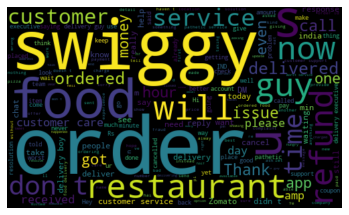

In [18]:
#picturing the most used words
import matplotlib.pyplot as plt
from wordcloud import WordCloud
# Plot The Word Cloud
allWords=" ".join([twts for twts in df_cleaned['full_text']] )
wordCloud = WordCloud(width =500, height=300, random_state=21, max_font_size = 119).generate(allWords)

plt.imshow(wordCloud, interpolation = "bilinear")
plt.axis('off')
plt.show()

In [19]:
# used to find the year
df_cleaned['year'].unique()

array(['2019'], dtype=object)

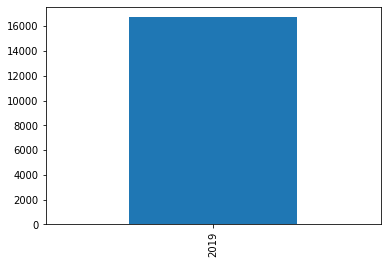

In [20]:
df_cleaned['year'].value_counts().plot.bar() 
# if all the rows tends to say a same information we can drop the feature

In [54]:
df_cleaned.drop(['year'], axis=1)
df_cleaned.head()

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id,Dates,Time,year,month,day
0,7/18/2019 22:47,0,82,219,2510 in The ultimate answer will b sorry ...,0,False,syamantak1,1,"6,19,59,419",2019-07-18,22:47:00,2019,07,18
1,7/18/2019 22:43,0,102,129,I hope so,0,False,Bharatbbhushn,2,"14,32,84,383",2019-07-18,22:43:00,2019,07,18
2,7/18/2019 22:37,0,102,129,I think you have the order details was the n...,0,False,Bharatbbhushn,3,"14,32,84,383",2019-07-18,22:37:00,2019,07,18
3,7/18/2019 22:35,0,13,16,in People are complaining here also i know Y...,0,False,taifkhalid01,4,"8,30,34,00,00,00,00,00,000",2019-07-18,22:35:00,2019,07,18
4,7/18/2019 22:25,0,102,129,Do you even know the meaning of your tagline ...,0,False,Bharatbbhushn,5,"14,32,84,383",2019-07-18,22:25:00,2019,07,18


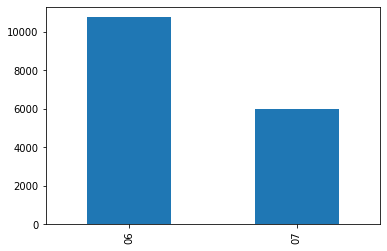

In [22]:
# finding the months
df_cleaned['month'].value_counts().plot.bar() 

# from this visualization we can find this dataset may be extracted inbetween the month of July

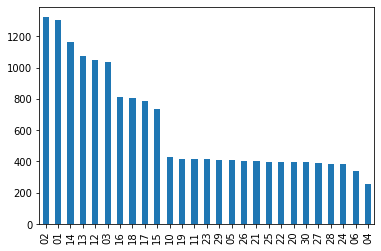

In [23]:
# this shows in a which all days where more tweets are tweeted so that Media team can be more active
df_cleaned['day'].sort_values(ascending=True).value_counts().plot.bar()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f07150f8bb0>]],
      dtype=object)

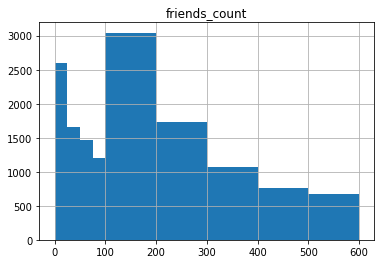

In [24]:
df_cleaned.hist("friends_count", bins = [0, 25, 50, 75, 100,200,300,400,500,600])

#this shows that there are more than 3000 people who is having friends 100 to 200

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0715085520>]],
      dtype=object)

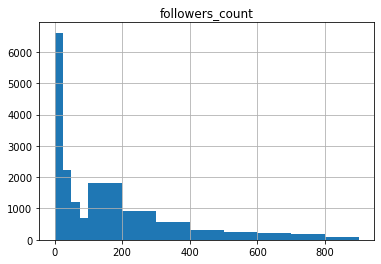

In [25]:
df_cleaned.hist("followers_count", bins = [0, 25, 50, 75, 100,200,300,400,500,600,700,800,900])


#this shows that more people who have tweeted have 0 followers

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f0717b86be0>]],
      dtype=object)

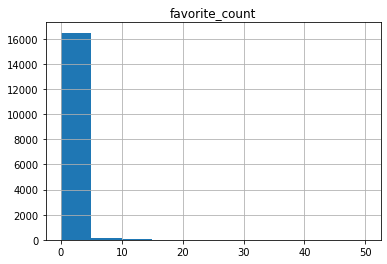

In [26]:
df_cleaned.hist("favorite_count", bins = [0,5,10,15,20,25,30,35,40,45,50])

# favorite_count is mostly all people having 0

In [27]:
#to install NRCLex
!pip install nrclex
!python -m textblob.download_corpora

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 396 kB 7.7 MB/s 
  Created wheel for nrclex: filename=NRCLex-3.0.0-py3-none-any.whl size=43329 sha256=155b1de1bb45fe2f84cdc639767a0f66a6d8e092c00c90e7eb2b8875e0565e8e
  Stored in directory: /root/.cache/pip/wheels/83/95/c0/42b43fb15eb48e4f5a67cba8915540cb2783591c59c037a9e5
Successfully built nrclex
[nltk_data] Downloading package brown to /root/nltk_data...
[nltk_data]   Unzipping corpora/brown.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package conll2000 to /root/nltk_data...
[nltk_data]   Unzipping corpora/conll2000.zip.
[nltk_data] Downlo

In [28]:
df_nrclex=df.copy() #dataframe for this model is df_nrclex

In [29]:
#importing the NRCLex libraries
import nltk
from nrclex import NRCLex

In [30]:
#All Emotion present in the text line

index=0 #count the values needed for recursion 
df_nrclex["full_text_emotion"] = None # creating a new feature in the dataframe to save the result
for tweet in df_nrclex['full_text']:
  tweet=str(tweet)
  emotion=NRCLex(tweet)
  a=emotion.top_emotions
  b=[list(ele) for ele in a]
  for i in range(len(b)): #deletes the score of the emotion
    del b[i][1]
  flat_list = [item for sublist in b for item in sublist] #converts the nested list to single list
  df_nrclex['full_text_emotion'].values[index]=flat_list  # creates a new feature and saves as - Positive or Negative or Neutral
  index+=1

In [31]:
# This analysis the extracted emotion and gives a needed output
a=['trust','surprise','positive','joy'] #these the positive emotion will be present in df_nrclex[full_text_emotion]
b=['negative','sadness','disgust','fear','anger','fear','anger'] #these the negsative emotion will be present in df_nrclex[full_text_emotion]
index=0
df_nrclex["full_text_binaryemotion"] = None #new column to save the exracted emotion
for prnd in df_nrclex['full_text_emotion']:
  positive=0 #to count the posivitve words in the df_nrclex[full_text_emotion]
  negative=0 #to count the negative words in the df_nrclex[full_text_emotion]
  for innerprnd in prnd: #iterate the words and checks the positive and negative
    if innerprnd in a:
      positive+=1
    if innerprnd in b:
      negative+=1
  if positive>negative: #assign the values to the new feature df_nrclex['full_text_binaryemotion']
    df_nrclex['full_text_binaryemotion'].values[index]="positive"
  elif negative>positive:
    df_nrclex['full_text_binaryemotion'].values[index]="negative"
  elif negative==positive:
    df_nrclex['full_text_binaryemotion'].values[index]="neutral"
  index+=1

In [32]:
df_nrclex.head()

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id,Dates,Time,year,month,day,full_text_emotion,full_text_binaryemotion
0,7/18/2019 22:47,0,82,219,2510 in The ultimate answer will b sorry ...,0,False,syamantak1,1,"6,19,59,419",2019-07-18,22:47:00,2019,07,18,"[trust, sadness, anticipation]",neutral
1,7/18/2019 22:43,0,102,129,I hope so,0,False,Bharatbbhushn,2,"14,32,84,383",2019-07-18,22:43:00,2019,07,18,"[trust, surprise, positive, joy, anticipation]",positive
2,7/18/2019 22:37,0,102,129,I think you have the order details was the n...,0,False,Bharatbbhushn,3,"14,32,84,383",2019-07-18,22:37:00,2019,07,18,"[trust, surprise, positive, joy, anticipation]",positive
3,7/18/2019 22:35,0,13,16,in People are complaining here also i know Y...,0,False,taifkhalid01,4,"8,30,34,00,00,00,00,00,000",2019-07-18,22:35:00,2019,07,18,"[positive, anticipation]",positive
4,7/18/2019 22:25,0,102,129,Do you even know the meaning of your tagline ...,0,False,Bharatbbhushn,5,"14,32,84,383",2019-07-18,22:25:00,2019,07,18,"[fear, anger, anticip, trust, surprise, positi...",negative


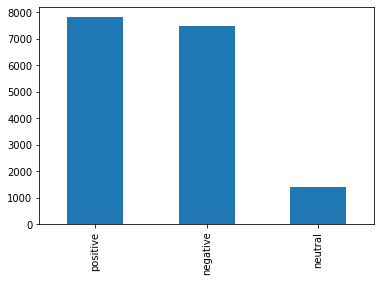

In [33]:
df_nrclex['full_text_binaryemotion'].value_counts().plot.bar()
# this visualize the output of the df_nrclex['full_text_binaryemotion']
# This shows the result as the most of the tweets are negative still the positive tweets are only just below the negative so the overall average will be same for positive and negaive.
# The neutral are less around 2000 with they are the future positive customers

In [34]:
#Calculate the percentage of the over all result

ptweets = df_nrclex[df_nrclex.full_text_binaryemotion =="positive"]
ntweets = df_nrclex[df_nrclex.full_text_binaryemotion =="negative"]
nltweets = df_nrclex[df_nrclex.full_text_binaryemotion =="neutral"]

ptweets = ptweets['full_text']
ntweets = ntweets['full_text']
nltweets = nltweets['full_text']

print("Postive : ",round(ptweets.shape[0]/df_nrclex.shape[0]*100,1))
print("Negative : ",round(ntweets.shape[0]/df_nrclex.shape[0]*100,1))
print("Neutral : ",round(nltweets.shape[0]/df_nrclex.shape[0]*100,1))

Postive :  46.8
Negative :  44.8
Neutral :  8.4


In [ ]:
#priority tweets
# this shows the tweets which is negative and who is having more followers count
# here followers_count is choosen because if a celebrity is tweeting they will have more followers not more friends.
#If follow are more for a person and if he/she tweets then Swiggy Media team should reply immediately to sustain the brand image
df_nrclex[df_nrclex.full_text_binaryemotion =="negative"].sort_values(by="followers_count",ascending=False)

In [35]:
df_textblob=df.copy() #dataframe for this model is df_textblob

In [36]:
#libraries
from textblob import TextBlob
from wordcloud import WordCloud

In [37]:
# function to get the subjectivity
def getSubjectivity(text) :
  return TextBlob(text).sentiment.subjectivity
# function to get the polarity
def getP01arity(text) :
  return TextBlob(text).sentiment.polarity
# features to save the subjectivity and polarity
df_textblob['Subjectivity'] = df_textblob['full_text'] . apply(getSubjectivity)
df_textblob['Polarity'] = df_textblob['full_text'] . apply(getP01arity)

In [38]:
# function fill up the feature
def getAnalysis(score):
  if score < 0:
    return 'Negative'
  elif score ==0:
    return 'Neutral'
  else:
    return 'Positive'
df_textblob['Analysis']= df_textblob['Polarity'].apply(getAnalysis)

In [39]:
df_textblob.head()

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id,Dates,Time,year,month,day,Subjectivity,Polarity,Analysis
0,7/18/2019 22:47,0,82,219,2510 in The ultimate answer will b sorry ...,0,False,syamantak1,1,"6,19,59,419",2019-07-18,22:47:00,2019,07,18,1.000000,-0.250000,Negative
1,7/18/2019 22:43,0,102,129,I hope so,0,False,Bharatbbhushn,2,"14,32,84,383",2019-07-18,22:43:00,2019,07,18,0.000000,0.000000,Neutral
2,7/18/2019 22:37,0,102,129,I think you have the order details was the n...,0,False,Bharatbbhushn,3,"14,32,84,383",2019-07-18,22:37:00,2019,07,18,0.267857,0.142857,Positive
3,7/18/2019 22:35,0,13,16,in People are complaining here also i know Y...,0,False,taifkhalid01,4,"8,30,34,00,00,00,00,00,000",2019-07-18,22:35:00,2019,07,18,0.625000,0.010417,Positive
4,7/18/2019 22:25,0,102,129,Do you even know the meaning of your tagline ...,0,False,Bharatbbhushn,5,"14,32,84,383",2019-07-18,22:25:00,2019,07,18,0.000000,0.000000,Neutral


In [40]:
#Calculate the percentage of the over all result

ptweets = df_textblob[df_textblob.Analysis =="Positive"]
ntweets = df_textblob[df_textblob.Analysis =="Negative"]
nltweets = df_textblob[df_textblob.Analysis =="Neutral"]

ptweets = ptweets['full_text']
ntweets = ntweets['full_text']
nltweets = nltweets['full_text']

print("Postive : ",round(ptweets.shape[0]/df_textblob.shape[0]*100,1))
print("Negative : ",round(ntweets.shape[0]/df_textblob.shape[0]*100,1))
print("Neutral : ",round(nltweets.shape[0]/df_textblob.shape[0]*100,1))

Postive :  32.8
Negative :  33.1
Neutral :  34.1


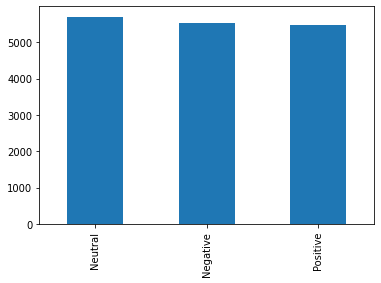

In [41]:
df_textblob['Analysis'].value_counts().plot.bar()
# this visualize the output of the df_textblob['Analysis']
# This shows the result as the most of the tweets are negative still the positive tweets are only just below the negative so the overall average will be same for positive and negaive and neutral.

In [53]:
#priority tweets
# this shows the tweets which is negative and who is having more followers count
# here followers_count is choosen because if a celebrity is tweeting they will have more followers not more friends.
#If follow are more for a person and if he/she tweets then Swiggy Media team should reply immediately to sustain the brand image
df_textblob[df_textblob.Analysis =="Negative"].sort_values(by="followers_count",ascending=False)

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id,Dates,Time,year,month,day,Subjectivity,Polarity,Analysis
6903,06-03-2019 10:50,4,1768478,376,in launched Swiggy Daily app for everyday ...,3,NaN,bsindia,"6,904","4,38,55,487",2019-06-03,10:50:00,2019,06,03,0.300000,-1.000000e-01,Negative
8372,6/29/2019 18:55,40,705266,376,If you want to order from in order on your ...,24,False,OYERJALOK,"8,373","8,53,03,665",2019-06-29,18:55:00,2019,06,29,0.683333,-9.251859e-18,Negative
5169,06-02-2019 14:12,0,688118,393,Obviously have skin in this game Rather th...,0,NaN,suchetadalal,"5,170","4,10,94,453",2019-06-02,14:12:00,2019,06,02,0.583333,-2.666667e-01,Negative
1194,6/22/2019 11:18,0,333045,1429,in your delivery boys are dangerous riders ...,0,False,EhsaanNoorani,"1,195","14,71,39,743",2019-06-22,11:18:00,2019,06,22,0.695833,-1.791667e-01,Negative
2165,6/19/2019 17:08,6,156294,155340,My orders on Swiggy gets delayed almost every ...,0,False,flywithsid,"2,166","8,33,29,113",2019-06-19,17:08:00,2019,06,19,0.188889,-3.333333e-02,Negative
9702,6/14/2019 8:20,0,86290,76387,Your reps are crazy they were earlier callin...,0,False,anandkapil,"9,703","7,18,36,829",2019-06-14,08:20:00,2019,06,14,0.793750,-4.000000e-01,Negative
9671,6/14/2019 9:06,0,86290,76387,Self boasting by Swiggy silly people from S...,0,False,anandkapil,"9,672","7,18,36,829",2019-06-14,09:06:00,2019,06,14,0.875000,-5.000000e-01,Negative
14016,07-03-2019 14:39,1,64337,916,India in Our life is not dependent on t...,0,False,surnell,"14,017","4,98,77,768",2019-07-03,14:39:00,2019,07,03,0.100000,-1.500000e-01,Negative
6908,06-03-2019 10:46,1,50735,717,in launches app for everyday homestyle meals,0,NaN,businessline,"6,909","92,94,762",2019-06-03,10:46:00,2019,06,03,0.600000,-2.000000e-01,Negative
9170,6/14/2019 19:01,4,50573,506,I m paying for this service bhai How this...,0,False,SmokingSkills_,"9,171","1,06,07,13,474",2019-06-14,19:01:00,2019,06,14,0.625000,-2.500000e-01,Negative


In [43]:
!pip install transformers #Download the model from the hugging face website
!pip install scipy #Used to convert the model result to probablity

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.8 MB 6.8 MB/s 
     |████████████████████████████████| 182 kB 40.3 MB/s 
     |████████████████████████████████| 7.6 MB 49.5 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [44]:
df_transformers=df.copy() #dataframe for this model

In [45]:
# libraries 
from transformers import pipeline
classifier = pipeline('sentiment-analysis')

No model was supplied, defaulted to distilbert-base-uncased-finetuned-sst-2-english and revision af0f99b (https://huggingface.co/distilbert-base-uncased-finetuned-sst-2-english).
Using a pipeline without specifying a model name and revision in production is not recommended.


Downloading:   0%|          | 0.00/629 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/268M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

In [46]:
# This saves the extracted result from the model to new feature 
index=0 #counter of recurssion
df_transformers["text_emotion"] = None 
df_transformers["emotion_score"] = None
for hugtweet in df_transformers['full_text']:
  var=classifier(hugtweet)[0]
  values = var.values()
  values = list(values)
  df_transformers['text_emotion'].values[index]=values[0]
  df_transformers['emotion_score'].values[index]=values[1]
  index+=1

In [49]:
df_transformers.tail()

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id,Dates,Time,year,month,day,text_emotion,emotion_score
16707,07-11-2019 12:13,0,0,2,they said as delivery box is not ready to del...,0,False,UmmeMohammad18,"16,708","11,44,99,00,00,00,00,00,000",2019-07-11,12:13:00,2019,07,11,NEGATIVE,0.998757
16708,07-11-2019 12:12,0,106,146,in Deliver to karta nahi install kyo karen,0,False,Desi_Life1,"16,709","10,39,41,00,00,00,00,00,000",2019-07-11,12:12:00,2019,07,11,NEGATIVE,0.941735
16709,07-11-2019 12:11,0,91,248,in thanks for spilling my drink I waited all...,0,False,Pinks_Forever_,"16,710","1,70,09,14,573",2019-07-11,12:11:00,2019,07,11,NEGATIVE,0.999297
16710,07-11-2019 12:11,0,0,2,hello there i use swigggy regularly to order ...,0,False,UmmeMohammad18,"16,711","11,44,99,00,00,00,00,00,000",2019-07-11,12:11:00,2019,07,11,NEGATIVE,0.996108
16711,07-11-2019 12:09,0,54,163,Humor in can you help my friend over here,0,False,TejasShelar2498,"16,712","7,17,51,10,00,00,00,00,000",2019-07-11,12:09:00,2019,07,11,POSITIVE,0.998752


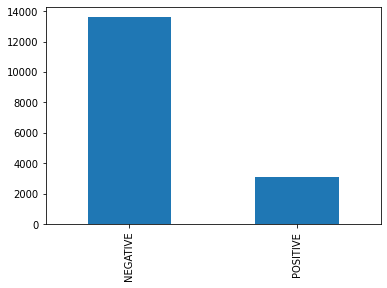

In [50]:
df_transformers['text_emotion'].value_counts().plot.bar()
# this visualize the output of the df_nrclex['full_text_binaryemotion']
# This shows the result as the most of the tweets are negative in this makes a strong stand thebrand image as negative.

In [47]:
#Calculate the percentage of the over all result
ptweets = df_transformers[df_transformers.text_emotion =="POSITIVE"]
ntweets = df_transformers[df_transformers.text_emotion =="NEGATIVE"]

ptweets = ptweets['full_text']
ntweets = ntweets['full_text']

print("Postive : ",round(ptweets.shape[0]/df_transformers.shape[0]*100,1))
print("Negative : ",round(ntweets.shape[0]/df_transformers.shape[0]*100,1))

Postive :  18.6
Negative :  81.4


In [48]:
#priority tweets
# this shows the tweets which is negative and who is having more followers count
# here followers_count is choosen because if a celebrity is tweeting they will have more followers not more friends.
#If follow are more for a person and if he/she tweets then Swiggy Media team should reply immediately to sustain the brand image
df_transformers[df_transformers.text_emotion =="NEGATIVE"].sort_values(by="followers_count",ascending=False)

,date,favorite_count,followers_count,friends_count,full_text,retweet_count,retweeted,screen_name,tweet_id,user_id,Dates,Time,year,month,day,text_emotion,emotion_score
6937,06-03-2019 10:05,5,1815609,289,New app for ordering tiffins homestyle meals ...,0,NaN,livemint,"6,938","1,76,73,635",2019-06-03,10:05:00,2019,06,03,NEGATIVE,0.997967
6558,06-03-2019 18:55,15,1768478,376,in has launched a homestyle meal subscriptio...,6,NaN,bsindia,"6,559","4,38,55,487",2019-06-03,18:55:00,2019,06,03,NEGATIVE,0.945453
6903,06-03-2019 10:50,4,1768478,376,in launched Swiggy Daily app for everyday ...,3,NaN,bsindia,"6,904","4,38,55,487",2019-06-03,10:50:00,2019,06,03,NEGATIVE,0.990167
8372,6/29/2019 18:55,40,705266,376,If you want to order from in order on your ...,24,False,OYERJALOK,"8,373","8,53,03,665",2019-06-29,18:55:00,2019,06,29,NEGATIVE,0.999317
5169,06-02-2019 14:12,0,688118,393,Obviously have skin in this game Rather th...,0,NaN,suchetadalal,"5,170","4,10,94,453",2019-06-02,14:12:00,2019,06,02,NEGATIVE,0.968527
5569,06-02-2019 07:05,56,688118,393,Oh well lunch plans gone for a toss becuase ...,23,NaN,suchetadalal,"5,570","4,10,94,453",2019-06-02,07:05:00,2019,06,02,NEGATIVE,0.980221
4407,6/26/2019 12:32,38,672613,234,ALERT Are you planning to order food fro...,25,False,moneycontrolcom,"4,408","6,89,27,629",2019-06-26,12:32:00,2019,06,26,NEGATIVE,0.998834
2200,6/19/2019 16:35,8,672543,234,Food delivery unicorn IN is in talks to raise...,1,False,moneycontrolcom,"2,201","6,89,27,629",2019-06-19,16:35:00,2019,06,19,NEGATIVE,0.976776
7318,6/15/2019 16:36,474,418461,126,Hey in it s time you guys came up with the o...,12,False,pnavdeep26,"7,319","32,71,40,609",2019-06-15,16:36:00,2019,06,15,NEGATIVE,0.953545
11568,07-01-2019 19:21,0,291401,686,Do you guys cover the costs of the damage c...,0,False,praveenachary,"11,569","2,13,67,788",2019-07-01,19:21:00,2019,07,01,NEGATIVE,0.997867
